# Corellation between Spectra

In [1]:
import SNIDsn
import SNIDdataset as snid
import numpy as np
import SNePCA

import plotly.plotly as ply
import plotly.graph_objs as go
import plotly.tools as tls

import matplotlib.pyplot as plt

import pandas as pd
import seaborn
from BinSpectra import lowres_dataset
from BinSpectra import random_noise_dataset
from BinSpectra import replace_flux_with_noise
import warnings
from progress.bar import Bar
import random
from numpy import cov
from scipy.stats import pearsonr
from scipy.stats import spearmanr

#warnings.filterwarnings('ignore')
#warnings.filterwarnings(action='once')
PATH = '../Data/DataProducts/'

In [3]:
def loaddata(phase):
    """
    Loads the pickled dataset
    """
    dsname = "dataset{}.pickle".format(phase)
    return snid.loadPickle(PATH + dsname)   


def remove_sne(dataset):
    dataset_key_list = list(dataset.keys())
    for key in dataset_key_list:
        if dataset[key].header['TypeStr'] == 'Ib-pec':
            del dataset[key]
        elif dataset[key].header['TypeStr'] == 'Ic-pec':
            del dataset[key]
    return dataset


def get_bin_length(phase, bin_factor):
    dataset = loaddata(phase)
    dataset_key_list = list(dataset.keys())
    wvl = dataset[dataset_key_list[0]].wavelengths
    wbin = (np.log(wvl[1]) - np.log(wvl[0])) * bin_factor
    return wbin



def runPCA(phase, bin_length, dphase=5, noise=False):
    dataset = loaddata(phase)
    if noise:
        dataset = replace_flux_with_noise(dataset)
        dataset_lowres = lowres_dataset(dataset, bin_length)
    else:
        dataset_lowres = lowres_dataset(dataset, bin_length)
    snidPCA_ph = SNePCA.SNePCA(dataset_lowres, phase - dphase, phase + dphase)
    snidPCA_ph.snidPCA()
    snidPCA_ph.calcPCACoeffs()
    return snidPCA_ph


def Dataset_dict(phase, bin_length):
    dataset = remove_sne(loaddata(phase))
    dataset = lowres_dataset(dataset, bin_length)
    dataset_key_list = list(dataset.keys())
    SNe_dict = {}
    for key in dataset_key_list:
        SNe_dict[key] = dataset[key].data.astype('float64')
    dataframe = pd.DataFrame(data = SNe_dict)
    return dataframe

## 1. Peak Phase

In [13]:
bin_length = get_bin_length(0, 1)
dataframe_0 = Dataset_dict(0, bin_length)

dataframe_0.head()

,sn1998dt,sn1999dn,sn1999ex,sn2004gq,sn2005bf,sn2005hg,sn2007ag,sn2007C,sn2007kj,sn2007Y,...,sn2002ap,sn2003jd,sn2003lw,sn2006aj,sn2007ru,sn2009bb,sn2010bh,sn2012ap,sn2012bz,sn2013dx
0,0.099465,0.105831,0.028141,0.040828,0.161510,0.229819,0.169907,0.117130,0.186637,0.206502,...,0.016992,0.036111,-0.086481,0.005182,0.064655,0.002124,0.044944,0.044446,0.013940,0.037538
1,0.089744,0.127695,0.027019,0.036800,0.207570,0.316935,0.234341,0.154501,0.230181,0.266396,...,0.009736,0.037748,-0.097774,0.006793,0.066577,0.002976,0.051356,0.040907,0.012382,0.039349
2,0.066659,0.138131,0.011669,0.028039,0.238837,0.356056,0.275778,0.178373,0.242719,0.293763,...,0.002115,0.038338,-0.107604,0.008481,0.067948,0.004643,0.057643,0.037178,0.010252,0.040402
3,0.034131,0.132217,-0.019685,0.015455,0.248519,0.339300,0.283362,0.186544,0.219410,0.283253,...,-0.005693,0.037961,-0.115716,0.010127,0.068830,0.007027,0.063538,0.033377,0.007595,0.040491
4,0.000037,0.111639,-0.063084,0.000363,0.237050,0.278688,0.254371,0.179689,0.168887,0.243121,...,-0.013493,0.036733,-0.121887,0.011605,0.069290,0.009982,0.068762,0.029624,0.004475,0.039452


## 1.1 Full resolution

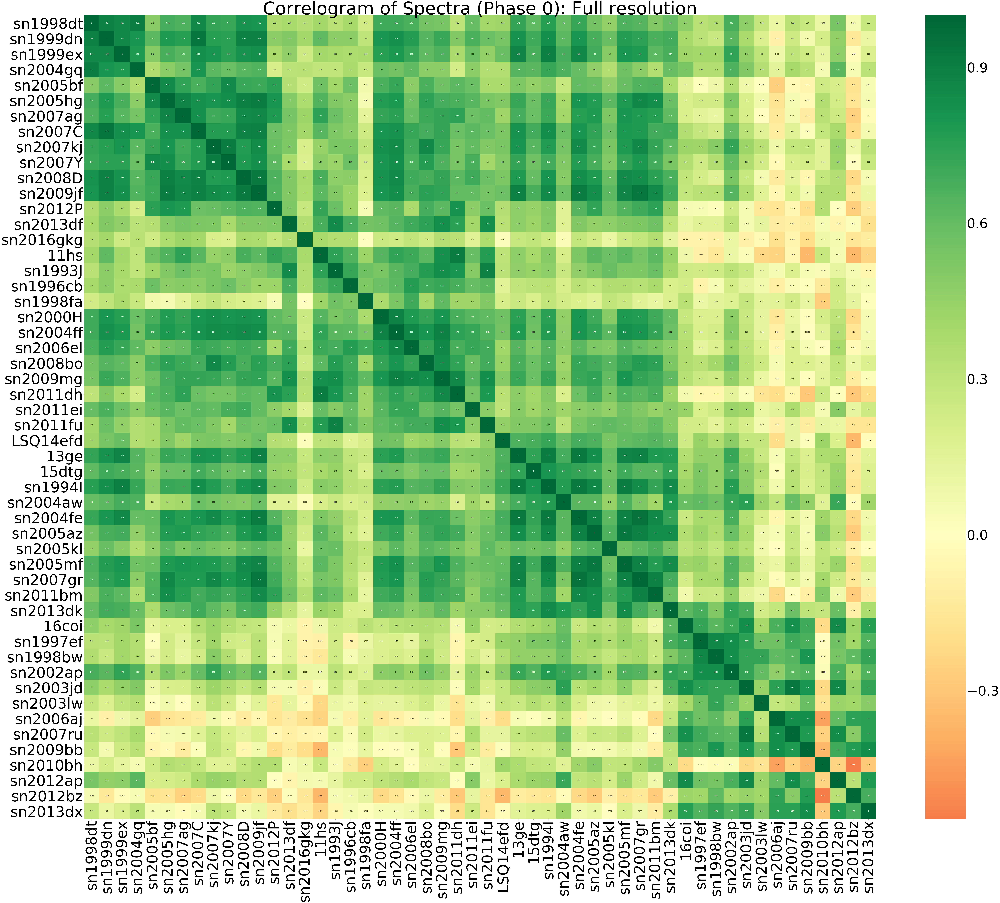

In [26]:
bin_length = get_bin_length(0, 1)
dataframe = Dataset_dict(0, bin_length)

plt.figure(figsize=(120,100))
ax = seaborn.heatmap(dataframe.corr(), xticklabels = dataframe.corr().columns, yticklabels = dataframe.corr().columns, cmap='RdYlGn', center = 0, annot = True)

plt.title('Correlogram of Spectra (Phase 0): Full resolution', fontsize=120)
plt.xticks(rotation = 90, fontsize=100)
plt.yticks(rotation = 0, fontsize=100)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=90)
plt.show()

## 1.1 Lowest resolution

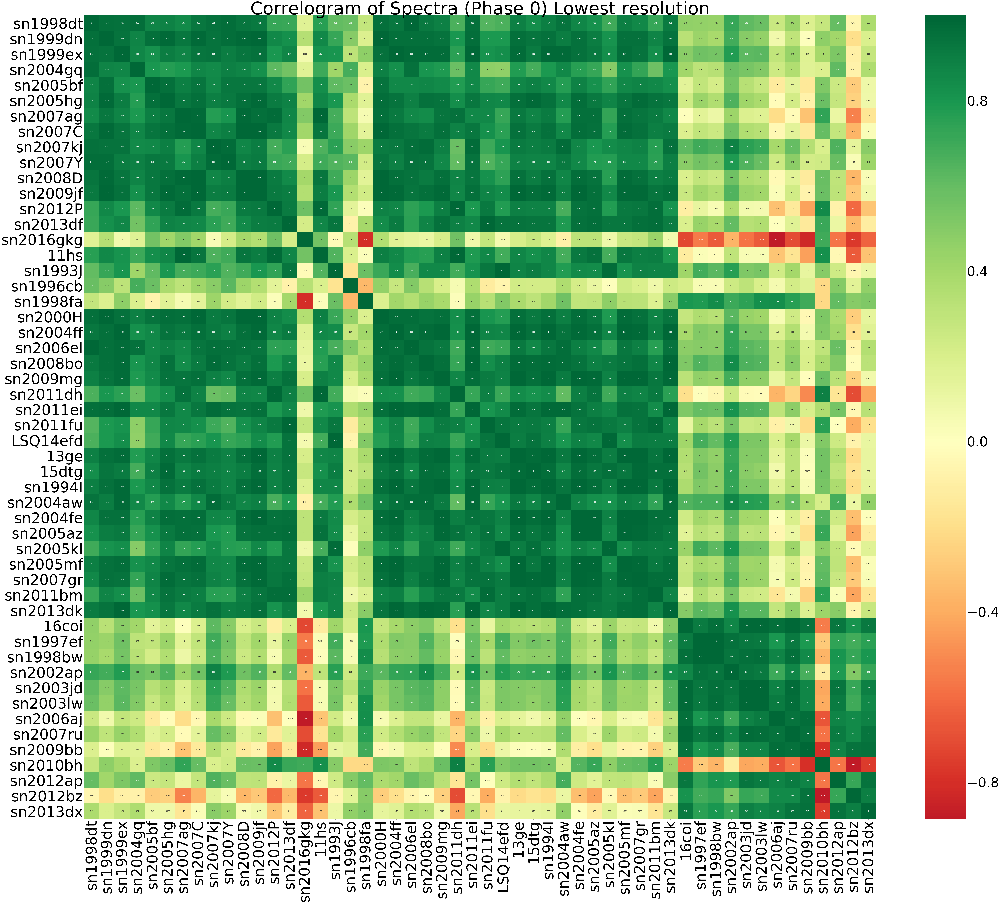

In [27]:
bin_length = get_bin_length(0, 82)
dataframe = Dataset_dict(0, bin_length)

plt.figure(figsize=(120,100))
ax = seaborn.heatmap(dataframe.corr(), xticklabels = dataframe.corr().columns, yticklabels = dataframe.corr().columns, cmap='RdYlGn', center = 0, annot = True)

plt.title('Correlogram of Spectra (Phase 0) Lowest resolution', fontsize=120)
plt.xticks(rotation = 90, fontsize=100)
plt.yticks(rotation = 0, fontsize=100)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=90)
plt.show()

## 2. Phase: 5 $\pm$ 5 days after peak

## 2.1 Full resolution

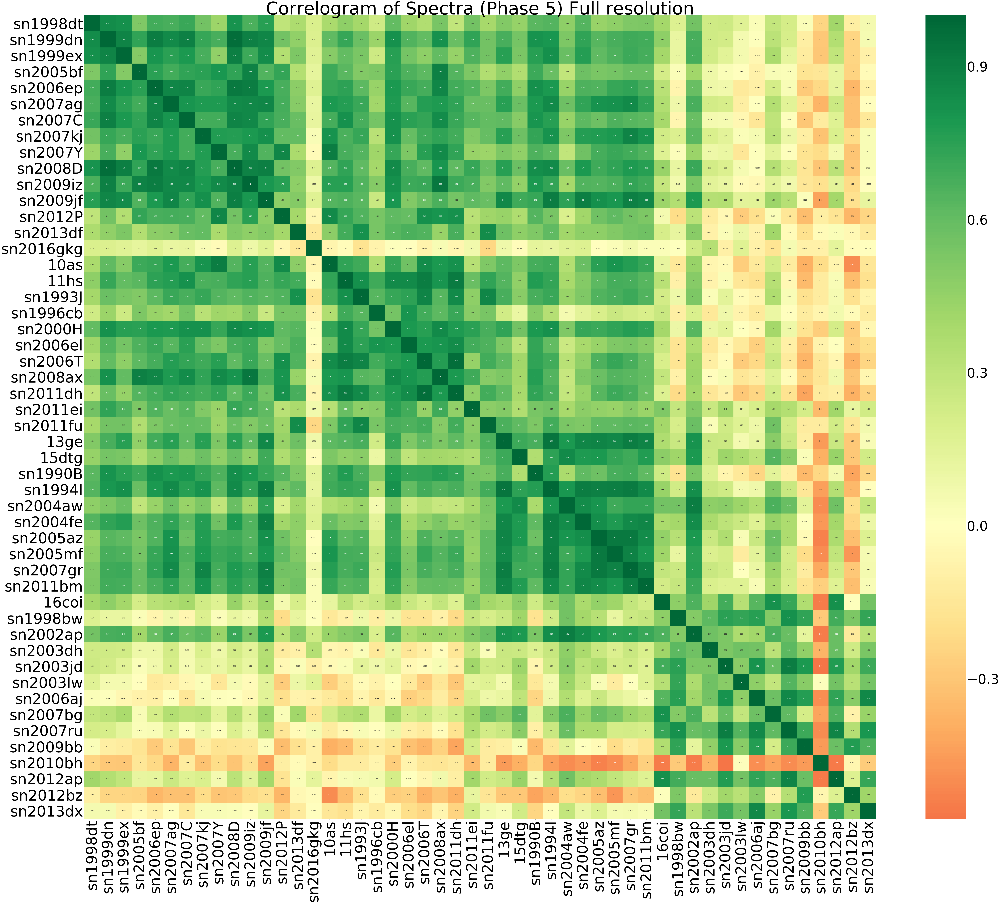

In [28]:
bin_length = get_bin_length(5, 1)
dataframe = Dataset_dict(5, bin_length)

plt.figure(figsize=(120,100))
ax = seaborn.heatmap(dataframe.corr(), xticklabels = dataframe.corr().columns, yticklabels = dataframe.corr().columns, cmap='RdYlGn', center = 0, annot = True)

plt.title('Correlogram of Spectra (Phase 5) Full resolution', fontsize=120)
plt.xticks(rotation = 90, fontsize=100)
plt.yticks(rotation = 0, fontsize=100)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=90)
plt.show()

## 2.2 Lowest resolution

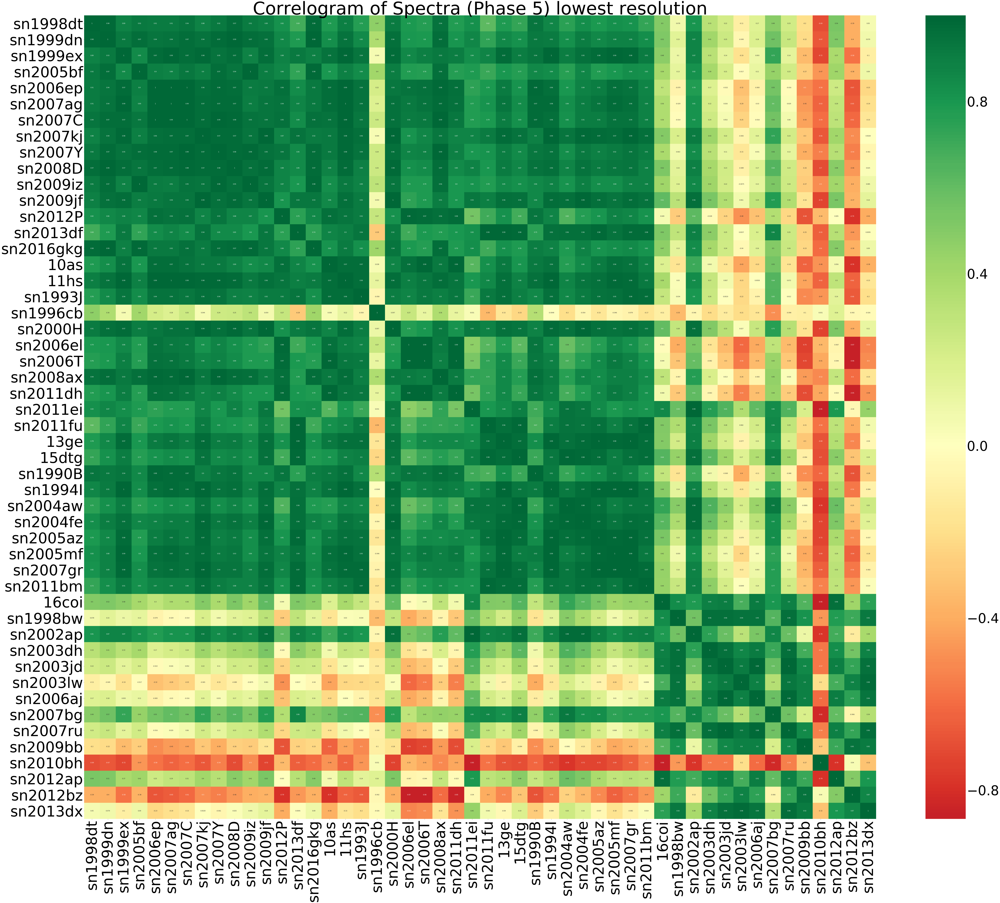

In [25]:
bin_length = get_bin_length(5, 82)
dataframe = Dataset_dict(5, bin_length)

plt.figure(figsize=(120,100))
ax = seaborn.heatmap(dataframe.corr(), xticklabels = dataframe.corr().columns, yticklabels = dataframe.corr().columns, cmap='RdYlGn', center = 0, annot = True)

plt.title('Correlogram of Spectra (Phase 5) lowest resolution', fontsize=120)
plt.xticks(rotation = 90, fontsize=100)
plt.yticks(rotation = 0, fontsize=100)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=90)
plt.show()

## 3. Phase: 10 $\pm$ 5 days after peak

## 3.1 Full resolution

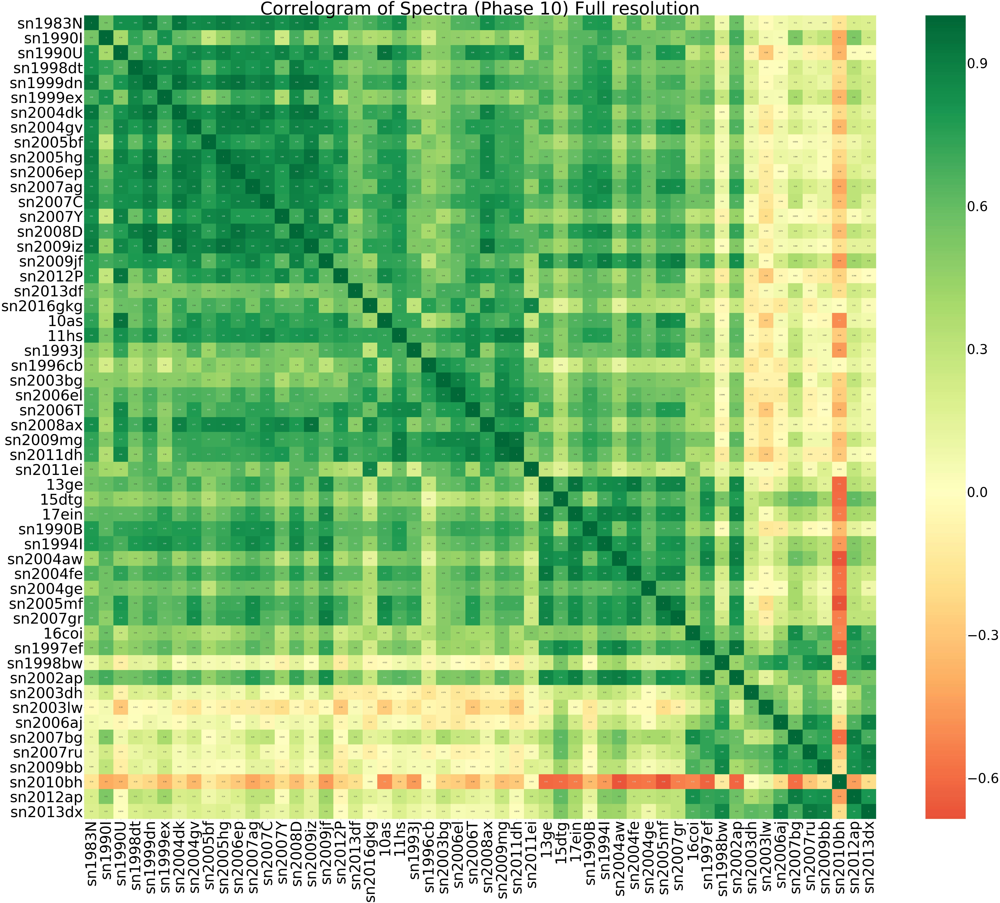

In [29]:
bin_length = get_bin_length(10, 1)
dataframe = Dataset_dict(10, bin_length)

plt.figure(figsize=(120,100))
ax = seaborn.heatmap(dataframe.corr(), xticklabels = dataframe.corr().columns, yticklabels = dataframe.corr().columns, cmap='RdYlGn', center = 0, annot = True)

plt.title('Correlogram of Spectra (Phase 10) Full resolution', fontsize=120)
plt.xticks(rotation = 90, fontsize=100)
plt.yticks(rotation = 0, fontsize=100)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=90)
plt.show()

## 3.2 Lowest resolution

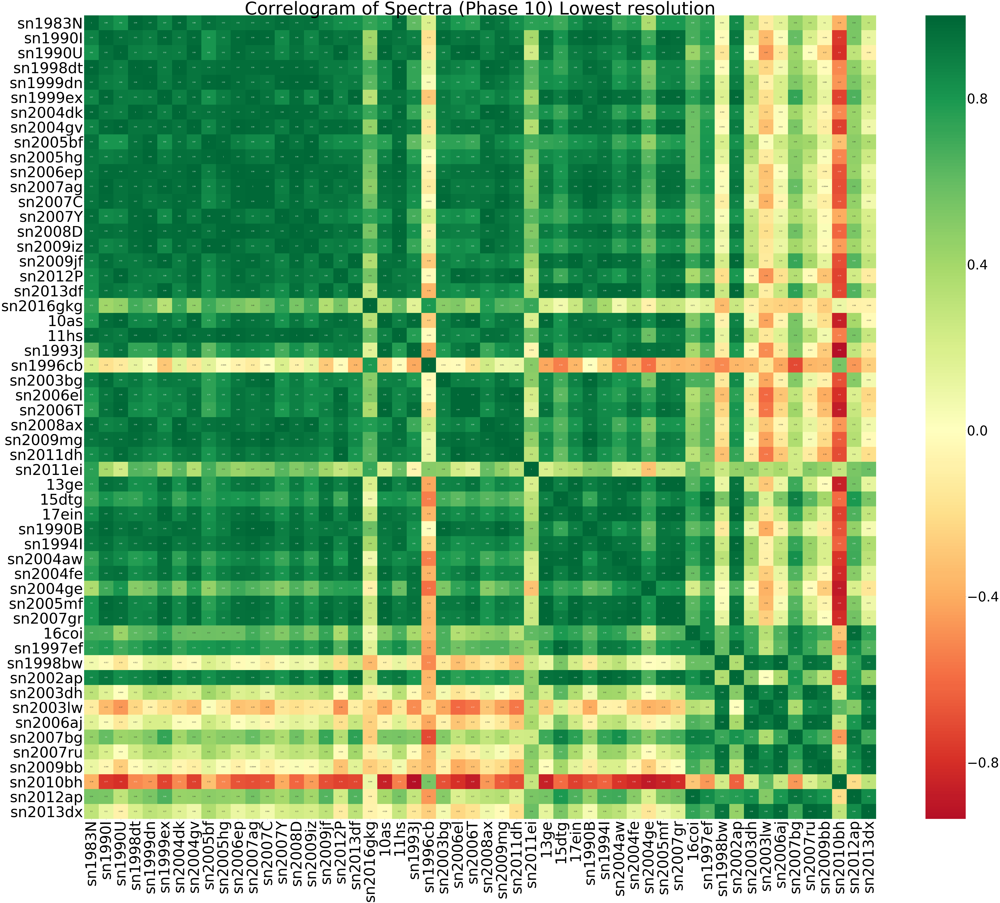

In [30]:
bin_length = get_bin_length(10, 82)
dataframe = Dataset_dict(10, bin_length)

plt.figure(figsize=(120,100))
ax = seaborn.heatmap(dataframe.corr(), xticklabels = dataframe.corr().columns, yticklabels = dataframe.corr().columns, cmap='RdYlGn', center = 0, annot = True)

plt.title('Correlogram of Spectra (Phase 10) Lowest resolution', fontsize=120)
plt.xticks(rotation = 90, fontsize=100)
plt.yticks(rotation = 0, fontsize=100)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=90)
plt.show()

## 4. Phase: 15 $\pm$ 5 days after peak

## 4.1 Full resolution

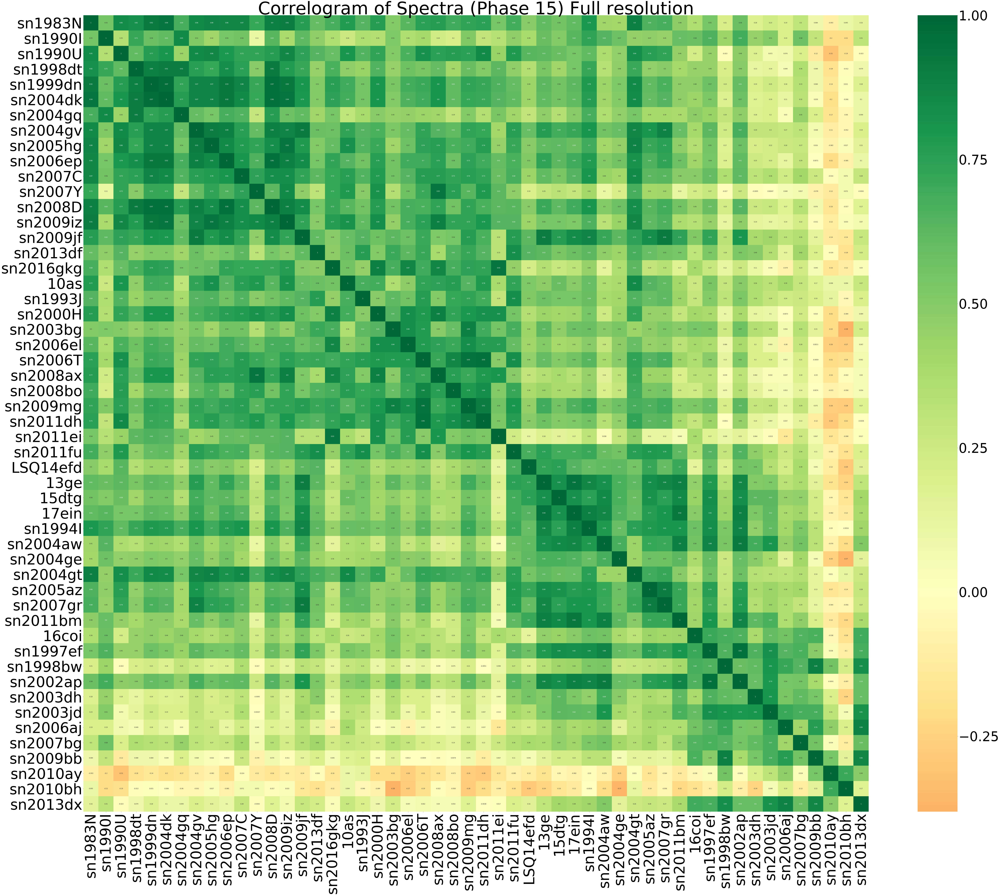

In [31]:
bin_length = get_bin_length(15, 1)
dataframe = Dataset_dict(15, bin_length)

plt.figure(figsize=(120,100))
ax = seaborn.heatmap(dataframe.corr(), xticklabels = dataframe.corr().columns, yticklabels = dataframe.corr().columns, cmap='RdYlGn', center = 0, annot = True)

plt.title('Correlogram of Spectra (Phase 15) Full resolution', fontsize=120)
plt.xticks(rotation = 90, fontsize=100)
plt.yticks(rotation = 0, fontsize=100)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=90)
plt.show()

## 4.2 Lowest resolution

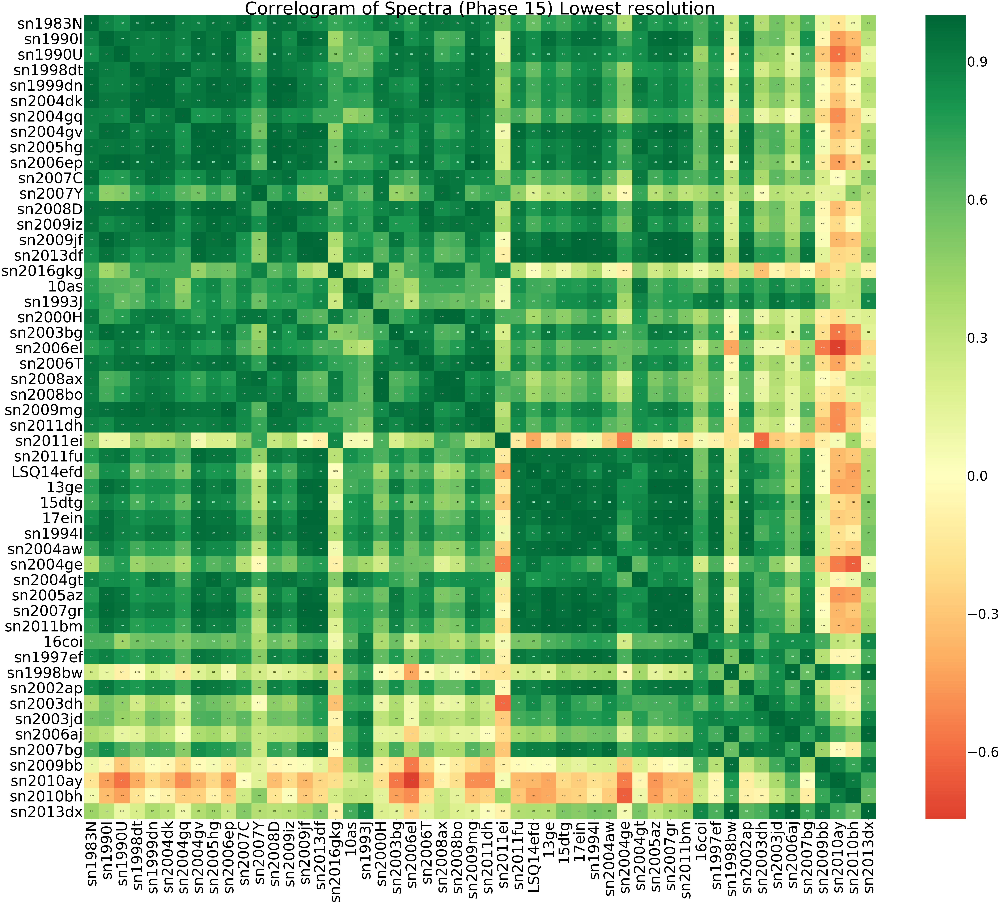

In [32]:
bin_length = get_bin_length(15, 82)
dataframe = Dataset_dict(15, bin_length)

plt.figure(figsize=(120,100))
ax = seaborn.heatmap(dataframe.corr(), xticklabels = dataframe.corr().columns, yticklabels = dataframe.corr().columns, cmap='RdYlGn', center = 0, annot = True)

plt.title('Correlogram of Spectra (Phase 15) Lowest resolution', fontsize=120)
plt.xticks(rotation = 90, fontsize=100)
plt.yticks(rotation = 0, fontsize=100)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=90)
plt.show()

# Summary: I checked the correlation of spectra in all four datasets corresponding to 4 phases at both the original (Full) and our lowest resolution. The spectra remain corellated even at lowest resolution which explains higher SVM scores at lower resolutions.